To do:
   
Refactor

One plot with 1, 2 or 3 planes
Option to specify opacity
Option to specify where to draw plane (e.g. in middle or at edge of box)

Replace scatter plot for molecule with surface plot? - https://github.com/plotly/plotly.py/issues/141

3 plots with slider for each plane

1 plot with 3 sliders? - See link from: https://community.plotly.com/t/two-slider-controls-for-single-plot-with-two-parameters/13900

## Slice in volumetric data, via Plotly ##

A volume included in a parallelepiped is described by the values of  a scalar field, $f(x,y,z)$, with $x\in[a,b]$, $y\in [c,d]$, $z\in[e,f]$.
A slice in this volume is visualized by coloring the surface of the slice, according to the values of the function f, restricted to that surface.

In order to plot a planar or a nonlinear slice of equation z=s(x,y) one proceeds as follows:

- define a meshgrid in x,y;
- evaluate z=s(x,y)
- define an instance of the Plotly Surface class, that represents the surface z=s(x,y)
- this surface is colored according to the values,  f(x,y,z), at its points. More precisely, the normalized values of the function f  are mapped to a colormap/colorscale.

With obvious modications we get slices of equation $x=s(y,z), y=s(z,x)$.

In [1]:
import numpy as np
import plotly.graph_objects as go
#from IPython

Define a function that returns a slice as a Plotly Surface:

In [2]:
def get_the_slice(x,y,z, surfacecolor):
    return go.Surface(x=x,
                      y=y,
                      z=z,
                      surfacecolor=surfacecolor,
                      opacity=0.8,
                      coloraxis='coloraxis')

In [3]:
def get_lims_colors(surfacecolor):# color limits for a slice
    return np.min(surfacecolor), np.max(surfacecolor)

Let us plot the slices z=0 and y=-0.5 in the volume defined by:

In [4]:
import sys
sys.path.insert(1, '/home/james/PostDoc/programs')
import RISM_grids as rg
print(rg.__version__)

# Read correlation functions:

dx_file = '/home/james/PostDoc/FreeSolv/RISM/solvcut_test/8/mobley_6935906/conf0/mobley_6935906_conf0_guv.O.1.dx'

guv_8 = rg.Grid3D.FromDxFile(dx_file)

#dx_file = '/home/james/PostDoc/FreeSolv/RISM/solvcut_test/18/mobley_6935906/conf0/mobley_6935906_conf0_guv.O.1.dx'
#guv_18 = rg.Grid3D.FromDxFile(dx_file)

2
Reading Dx file: /home/james/PostDoc/FreeSolv/RISM/solvcut_test/8/mobley_6935906/conf0/mobley_6935906_conf0_guv.O.1.dx


In [5]:
scalar_f = lambda x,y,z: x*np.exp(-x**2-y**2-z**2)

In [11]:
x = np.linspace(0, 30, 60)
y = np.linspace(0, 30, 60)
x, y = np.meshgrid(x,y)
z = np.ones(x.shape)*0
surfcolor_z = guv_8.slice('x', 50).grid[20:80, 20:80]

surfcolor_z

sminz, smaxz = get_lims_colors(surfcolor_z)

slice_z = get_the_slice(x, y, z, surfcolor_z)

In [15]:
x = np.linspace(0, 30, 60)
z = np.linspace(0, 30, 60)
x, z = np.meshgrid(x,z)
y = np.ones(x.shape)*0
surfcolor_y = guv_8.slice('y', 50).grid[20:80, 20:80]
sminy, smaxy = get_lims_colors(surfcolor_y)
vmin = min([sminz, sminy])
vmax = max([smaxz, smaxy])
slice_y = get_the_slice(x, y, z, surfcolor_y)

In [16]:
y = np.linspace(0, 30, 60)
z = np.linspace(0, 30, 60)
y, z = np.meshgrid(y,z)
x = np.ones(x.shape)*0
surfcolor_x = guv_8.slice('z', 50).grid[20:80, 20:80]
sminx, smaxx = get_lims_colors(surfcolor_x)
vmin = min([sminz, sminy, sminx])
vmax = max([smaxz, smaxy, smaxx])
slice_x = get_the_slice(x, y, z, surfcolor_x)

In [17]:
# x = np.linspace(-2,2, 50)
# y = np.linspace(-2,2, 50)
# x, y = np.meshgrid(x,y)
# z = np.zeros(x.shape)
# surfcolor_z = scalar_f(x,y,z)
# sminz, smaxz = get_lims_colors(surfcolor_z)

# slice_z = get_the_slice(x, y, z, surfcolor_z)

In [18]:
# x = np.linspace(-2,2, 50)
# z = np.linspace(-2,2, 50)
# x, z = np.meshgrid(x,y)
# y = -0.5 * np.ones(x.shape)
# surfcolor_y = scalar_f(x,y,z)
# sminy, smaxy = get_lims_colors(surfcolor_y)
# vmin = min([sminz, sminy])
# vmax = max([smaxz, smaxy])
# slice_y = get_the_slice(x, y, z, surfcolor_y)

In order to be able to compare  the two slices, we choose a unique interval of values to be mapped to the colorscale:

In [19]:
def colorax(vmin, vmax):
    return dict(cmin=vmin,
                cmax=vmax)

In [24]:
trace2 = go.Scatter3d(x=[15, 16],
                y= [15, 16],
                z= [15, 16],
                mode = 'markers',
                line=dict(width=3,color='orange'),
                #marker=dict(size=5,color='red'),
                text='ch2',
                name = 'ch2',
                hoverinfo='text')

trace2 = go.Surface(x=[15],
                y= [15],
                z= [15],
                #mode = 'markers',
                #line=dict(width=3,color='orange'),
                #marker=dict(size=5,color='red'),
                text='ch2',
                name = 'ch2',
                hoverinfo='text')

trace3 = go.Scatter3d(x=[14],
                y= [14],
                z= [14],
                mode = 'markers',
                line=dict(width=3,color='blue'),
                #marker=dict(size=5,color='red'),
                text='ch2',
                name = 'ch2',
                hoverinfo='text')

fig1 = go.Figure(data=[slice_z, slice_y, slice_x, trace2, trace3])
fig1.update_layout(
         title_text='Slices in volumetric data', 
         title_x=0.5,
         width=700,
         height=700,
         scene_zaxis_range=[0,30], 
         coloraxis=dict(colorscale='BrBG',
                        colorbar_thickness=25,
                        colorbar_len=0.75,
                        **colorax(vmin, vmax)))            
      
#fig1.show()  

In [28]:
theta = 1.3
phi=2.1

np.outer(np.cos(theta),np.sin(phi))

array([[0.23090749]])

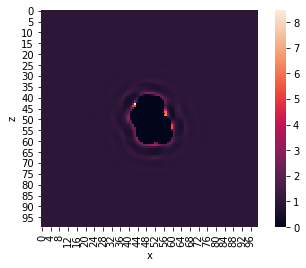

In [16]:
# Check that axis direction matches figure above
guv_8.slice('j', 50).plt()

In [13]:
dx_file = '/home/james/PostDoc/programs/mobley_7754849_conf0_guv.O.1.dx'

#dx_file = '/home/james/PostDoc/FreeSolv/RISM/solvcut_test/8/mobley_6935906/conf0/mobley_6935906_conf0_guv.O.1.dx'

guv_8 = rg.Grid3D.FromDxFile(dx_file)

# def defsurf(grid, cut_i, x_i, y_i, z_i):
#     x = np.linspace(0, grid.gridsize[x_i]*grid.gridstep[x_i], grid.gridsize[x_i])
#     y = np.linspace(0, grid.gridsize[y_i]*grid.gridstep[y_i], grid.gridsize[y_i])
#     #print(x)
#     x, y = np.meshgrid(x,y)
#     z = np.ones(x.shape)*0 #grid.gridsize[x_i]/4 # 0
#     surfcolor_z = guv_8.slice(cut_i, 34).grid

#     sminz, smaxz = get_lims_colors(surfcolor_z)

#     coords = [x, y, z]
    
#     slice_z = get_the_slice(coords[x_i], coords[y_i], coords[z_i], surfcolor_z)

#     return slice_z, sminz, smaxz


def defsurf(rism, x_i, y_i, z_i):
    i = np.linspace(rism.origin[x_i], 
                    rism.origin[x_i] + rism.gridsize[x_i]*rism.gridstep[x_i], 
                    rism.gridsize[x_i])
    j = np.linspace(rism.origin[y_i], 
                    rism.origin[y_i] + rism.gridsize[y_i]*rism.gridstep[y_i], 
                    rism.gridsize[y_i])
    #print(i)
    #y = np.linspace(0, grid.gridsize[y_i]*grid.gridstep[y_i], grid.gridsize[y_i])
    
    #print(x)
    i, j = np.meshgrid(i, j)
    #print(i)
    # z needs to be 0 for planes to align?
    k = np.ones(i.shape)*0 #rism.origin[z_i] #grid.gridsize[x_i]/4 # 0
    cut_ax = {0 : 'i', 1 : 'j', 2 : 'k'}
    surfcolor_z = rism.slice(cut_ax[z_i], 34).grid

    sminz, smaxz = get_lims_colors(surfcolor_z)

    coords = [i, j, k]
    
    co = np.argsort([x_i, y_i, z_i])
    
    slice_z = get_the_slice(coords[co[0]], coords[co[1]], coords[co[2]], surfcolor_z)
    #slice_z = get_the_slice(i, j, k, surfcolor_z)

    return slice_z, sminz, smaxz


# slice_x, vminx, vmaxx = defsurf(guv_8, 'i', 1, 2, 0)
# slice_y, vminy, vmaxy = defsurf(guv_8, 'j', 2, 0, 1)
# slice_z, vminz, vmaxz = defsurf(guv_8, 'k', 0, 1, 2)

# # This should work?:
# slice_x, vminx, vmaxx = defsurf(guv_8, 1, 2, 0)
# slice_y, vminy, vmaxy = defsurf(guv_8, 2, 0, 1)
# slice_z, vminz, vmaxz = defsurf(guv_8, 0, 1, 2)


# This should work, but not sure why?:
# NEED TO SORT OUT ORDER OF AXES AND WHY THE LABELING IS WRONG IN 2D
# Something to do with mirror images?
slice_x, vminx, vmaxx = defsurf(guv_8, 2, 1, 0)
slice_y, vminy, vmaxy = defsurf(guv_8, 2, 0, 1)
slice_z, vminz, vmaxz = defsurf(guv_8, 1, 0, 2)


vmin = min([vminx, vminy, vminz])
vmax = max([vmaxx, vmaxy, vmaxz])
vmax=4

def colorax(vmin, vmax):
    return dict(cmin=vmin,
                cmax=vmax)

fig1 = go.Figure(data=[slice_x, slice_y, slice_z])
fig1.update_layout(
         title_text='Slices in volumetric data', 
         title_x=0.5,
         width=700,
         height=700,
         #scene_zaxis_range=[0,30], 
         coloraxis=dict(colorscale='BrBG',
                        colorbar_thickness=25,
                        colorbar_len=0.75,
                        **colorax(vmin, vmax)))            
      
# #fig1.show()  
    

Reading Dx file: /home/james/PostDoc/programs/mobley_7754849_conf0_guv.O.1.dx


In [14]:
# Read in pdb file:

from rdkit.Chem.Draw import IPythonConsole
from rdkit import Chem
from rdkit.Chem import AllChem

mol = AllChem.MolFromPDBFile('/home/james/PostDoc/programs/mobley_7754849_conf0.pdb', removeHs=False)

atom_coords = mol.GetConformers()[0].GetPositions()

#atom_coords += np.array([17, 17, 17])

atoms = go.Scatter3d(
    x=atom_coords[:,0],
    y=atom_coords[:,1],
    z=atom_coords[:,2],
    mode = 'markers',
    line=dict(width=3,color='orange'),
    #marker=dict(size=5,color='red'),
    #text='ch2',
    #name = 'ch2',
    hoverinfo='text')

bond_lines = []
for bond_i in mol.GetBonds():
    bond0 = bond_i.GetBeginAtomIdx()
    bond1 = bond_i.GetEndAtomIdx()
    
    bond_lines += [go.Scatter3d(
        x=atom_coords[[bond0, bond1],0],
        y=atom_coords[[bond0, bond1],1],
        z=atom_coords[[bond0, bond1],2],
        mode = 'lines',
        line=dict(width=3,color='orange'), # grey
        #marker=dict(size=5,color='red'),
        #text=None,
        #name = None,
        #hoverinfo='text'
        )]

In [15]:
atom_colours = {'C' : 'cyan', 
                'H' : 'white',
                'O' : 'red',
                'N' : 'blue',
                'P' : 'gold',
                'S' : 'yellow'}

atom_sizes = {'C' : 4, 
              'H' : 2,
              'O' : 4,
              'N' : 4,
              'P' : 5,
              'S' : 5}

atom_sym_coords = {}
for i, atom in enumerate(mol.GetAtoms()):
    atom_sym = atom.GetSymbol()
    if atom_sym not in atom_sym_coords:
        atom_sym_coords[atom_sym] = []
    atom_sym_coords[atom_sym] += [atom_coords[i]]

atom_points = []
for atom_sym in atom_sym_coords.keys():
    ac = np.array(atom_sym_coords[atom_sym])
    atom_points += [go.Scatter3d(
        x=ac[:,0],
        y=ac[:,1],
        z=ac[:,2],
        mode = 'markers',
        marker=dict(size=atom_sizes[atom_sym],color=atom_colours[atom_sym]),
        #line=dict(size=5,color='red'),
        #text='ch2',
        #name = None,
        #hoverinfo='text'
        )]

In [16]:
fig1 = go.Figure(data=[slice_x, slice_y, slice_z] + atom_points + bond_lines)
fig1.update_layout(
         title_text='Slices in volumetric data', 
         title_x=0.5,
         width=700,
         height=700,
         showlegend=False,
         #scene_zaxis_range=[0,30], 
         coloraxis=dict(colorscale='Cividis', #'Viridis', #'BrBG',
                        colorbar_thickness=25,
                        colorbar_len=0.75,
                        **colorax(vmin, vmax)))

In [22]:
# Add sliders:
# https://plotly.com/python/sliders/

def defsurf(rism, x_i, y_i, z_i, slice_d):
    i = np.linspace(rism.origin[x_i], 
                    rism.origin[x_i] + rism.gridsize[x_i]*rism.gridstep[x_i], 
                    rism.gridsize[x_i])
    j = np.linspace(rism.origin[y_i], 
                    rism.origin[y_i] + rism.gridsize[y_i]*rism.gridstep[y_i], 
                    rism.gridsize[y_i])
    #print(i)
    #y = np.linspace(0, grid.gridsize[y_i]*grid.gridstep[y_i], grid.gridsize[y_i])
    
    #print(x)
    i, j = np.meshgrid(i, j)
    #print(i)
    # z needs to be 0 for planes to align?
    k = np.ones(i.shape)*rism.gridstep[z_i]*slice_d + rism.origin[z_i] # 0
    cut_ax = {0 : 'i', 1 : 'j', 2 : 'k'}
    surfcolor_z = rism.slice(cut_ax[z_i], slice_d).grid

    sminz, smaxz = get_lims_colors(surfcolor_z)

    coords = [i, j, k]
    
    co = np.argsort([x_i, y_i, z_i])
    
    slice_z = get_the_slice(coords[co[0]], coords[co[1]], coords[co[2]], surfcolor_z)
    #slice_z = get_the_slice(i, j, k, surfcolor_z)

    return slice_z, sminz, smaxz


fig1 = go.Figure(data=atom_points + bond_lines)

n_mol_traces = len(fig1.data)
print(n_mol_traces)
n_slices = len(range(0, 68, 2))

vmin = 10
vmax = 0
#slices = []

for x_i, y_i, z_i in [[2, 0, 1]]: # [2, 1, 0], [2, 0, 1], [1, 0, 2]]:
    for slice_d in range(0, 68, 2):
        #slice_x, vminx, vmaxx = defsurf(guv_8, 2, 1, 0, slice_d)
        slice_x, vminx, vmaxx = defsurf(guv_8, x_i, y_i, z_i, slice_d)
        vmin = min([vmin, vminx])
        vmax = max([vmax, vmaxx])
        fig1.add_trace(slice_x)

# Should this be + 1?
for d in fig1.data[n_mol_traces + 1:]:
    d.visible = False
#fig1.data[n_mol_traces].visible = True

# Up to here for multiple sliders:

steps = []
for i in range(len(fig1.data) - n_mol_traces):
    step = dict(
        method="update",
        args=[{"visible": [True]*n_mol_traces + [False] * (len(fig1.data) - n_mol_traces)},
              {"title": "Slider switched to step: " + str(i)}],  # layout attribute
    )
    step["args"][0]["visible"][i + n_mol_traces] = True  # Toggle i'th trace to "visible"
    steps.append(step)

    # Doesn't work:
sliders = [dict(
    active=0,
    currentvalue={"prefix": "x slice: "},
    pad={"t": 50},
    steps=steps
)]
# ,
#           dict(
#     active=10,
#     currentvalue={"prefix": "x slice: "},
#     pad={"t": 50},
#     steps=steps
# )]


#fig1 = go.Figure(data=[slice_x] + atom_points + bond_lines)
fig1.update_layout(
         title_text='Slices in volumetric data', 
         title_x=0.5,
         width=700,
         height=700,
         showlegend=False,
         scene_xaxis_range=[-16,16], 
         scene_yaxis_range=[-16,16], 
         scene_zaxis_range=[-16,16], 
         #scene_aspectmode='cube', #'data'
         scene_aspectratio=dict(x=1, y=1, z=1),
         coloraxis=dict(colorscale='BrBG',
                        colorbar_thickness=25,
                        colorbar_len=0.75,
                        **colorax(vmin, vmax)),
         sliders=sliders)

fig1.show()


45


# END

In [13]:
from IPython.display import IFrame    
IFrame('https://chart-studio.plotly.com/~empet/13862', width=700, height=700)

### Oblique slice in volumetric data ###

As an example we plot comparatively two slices: a slice through $z=0$ and an oblique planar slice, that is defined by rotating the plane z=0 by $\alpha=\pi/4$, about Oy.

Rotating the plane $z=c$ about Oy (from Oz towards Ox) with $\alpha$ radians we get the plane of equation
$z=c/\cos(\alpha)-x\tan(\alpha)$

In [21]:
alpha = np.pi/4
x = np.linspace(-2, 2, 50)
y = np.linspace(-2, 2, 50)
x, y = np.meshgrid(x,y)
z = -x * np.tan(alpha)

surfcolor_obl = scalar_f(x,y,z)

In [22]:
smino, smaxo = get_lims_colors(surfcolor_obl)
vmin = min([sminz, smino])
vmax = max([smaxz, smaxo])

In [23]:
slice_obl = get_the_slice(x,y,z, surfcolor_obl)


In [24]:
fig2 = go.Figure(data=[slice_z, slice_obl], layout=fig1.layout)
fig2.update_layout( coloraxis=colorax(vmin, vmax))

#fig2.show() 

In [25]:
IFrame('https://chart-studio.plotly.com/~empet/13864', width=700, height=700)

In [27]:
from IPython.core.display import HTML
def  css_styling():
    styles = open("./custom.css", "r").read()
    return HTML(styles)
css_styling()

FileNotFoundError: [Errno 2] No such file or directory: './custom.css'